In [1]:
import datashader as ds
import datashader.transfer_functions as tf
import datashader.glyphs
from datashader import reductions
from datashader.core import bypixel
from datashader.utils import lnglat_to_meters as webm, export_image
from datashader.colors import colormap_select, Greys9, viridis, inferno
import copy


from pyproj import Proj, transform
import numpy as np
import pandas as pd
import urllib
import json
import datetime
import colorlover as cl

import plotly.offline as py
import plotly.graph_objs as go
from plotly import tools

# from shapely.geometry import Point, Polygon, shape
# In order to get shapley, you'll need to run [pip install shapely.geometry] from your terminal

from functools import partial

from IPython.display import GeoJSON

py.init_notebook_mode()

For module 2 we'll be looking at techniques for dealing with big data. In particular binning strategies and the datashader library (which possibly proves we'll never need to bin large data for visualization ever again.)

To demonstrate these concepts we'll be looking at the PLUTO dataset put out by New York City's department of city planning. PLUTO contains data about every tax lot in New York City.

PLUTO data can be downloaded from [here](https://www1.nyc.gov/site/planning/data-maps/open-data/dwn-pluto-mappluto.page). Unzip them to the same directory as this notebook, and you should be able to read them in using this (or very similar) code. Also take note of the data dictionary, it'll come in handy for this assignment.

In [2]:
# Code to read in v17, column names have been updated (without upper case letters) for v18

# bk = pd.read_csv('PLUTO17v1.1/BK2017V11.csv')
# bx = pd.read_csv('PLUTO17v1.1/BX2017V11.csv')
# mn = pd.read_csv('PLUTO17v1.1/MN2017V11.csv')
# qn = pd.read_csv('PLUTO17v1.1/QN2017V11.csv')
# si = pd.read_csv('PLUTO17v1.1/SI2017V11.csv')

# ny = pd.concat([bk, bx, mn, qn, si], ignore_index=True)


ny = pd.read_csv('nyc_pluto_21v2_csv/pluto_21v2.csv', low_memory=False)


# Getting rid of some outliers
ny = ny[(ny['yearbuilt'] > 1850) & (ny['yearbuilt'] < 2020) & (ny['numfloors'] != 0)]

<br> 

Taking a moment to look at the basic structure of the `ny` DataFrame

<br>

In [3]:
print( ny.shape )
ny.head()

(810654, 90)


,borough,block,lot,cd,ct2010,cb2010,schooldist,council,zipcode,firecomp,...,appbbl,appdate,plutomapid,firm07_flag,pfirm15_flag,version,dcpedited,latitude,longitude,notes
1,MN,445,54,103.0,38.00,4000.0,1.0,2.0,10003.0,E028,...,NaN,NaN,1,NaN,NaN,21v2,NaN,40.725333,-73.988711,NaN
2,MN,467,55,103.0,40.00,2000.0,1.0,2.0,10003.0,L003,...,NaN,NaN,1,NaN,NaN,21v2,NaN,40.731190,-73.987721,NaN
3,BK,2621,7501,301.0,573.00,3003.0,14.0,33.0,11222.0,E238,...,3.026210e+09,01/23/2008,1,NaN,NaN,21v2,NaN,40.726484,-73.951001,NaN
4,MN,1970,58,109.0,213.03,1001.0,5.0,9.0,10027.0,E080,...,NaN,NaN,1,NaN,NaN,21v2,NaN,40.817053,-73.952741,NaN
5,BX,2646,7,201.0,77.00,1011.0,7.0,17.0,10456.0,E073,...,2.026460e+09,08/02/2005,1,NaN,NaN,21v2,NaN,40.819006,-73.906469,NaN


In [4]:
ny.columns

Index(['borough', 'block', 'lot', 'cd', 'ct2010', 'cb2010', 'schooldist',
       'council', 'zipcode', 'firecomp', 'policeprct', 'healthcenterdistrict',
       'healtharea', 'sanitboro', 'sanitdistrict', 'sanitsub', 'address',
       'zonedist1', 'zonedist2', 'zonedist3', 'zonedist4', 'overlay1',
       'overlay2', 'spdist1', 'spdist2', 'spdist3', 'ltdheight', 'splitzone',
       'bldgclass', 'landuse', 'easements', 'ownertype', 'ownername',
       'lotarea', 'bldgarea', 'comarea', 'resarea', 'officearea', 'retailarea',
       'garagearea', 'strgearea', 'factryarea', 'otherarea', 'areasource',
       'numbldgs', 'numfloors', 'unitsres', 'unitstotal', 'lotfront',
       'lotdepth', 'bldgfront', 'bldgdepth', 'ext', 'proxcode', 'irrlotcode',
       'lottype', 'bsmtcode', 'assessland', 'assesstot', 'exempttot',
       'yearbuilt', 'yearalter1', 'yearalter2', 'histdist', 'landmark',
       'builtfar', 'residfar', 'commfar', 'facilfar', 'borocode', 'bbl',
       'condono', 'tract2010', 'xcoo

In [5]:
ny.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 810654 entries, 1 to 858187
Data columns (total 90 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   borough               810654 non-null  object 
 1   block                 810654 non-null  int64  
 2   lot                   810654 non-null  int64  
 3   cd                    810541 non-null  float64
 4   ct2010                810541 non-null  float64
 5   cb2010                808795 non-null  float64
 6   schooldist            810541 non-null  float64
 7   council               810541 non-null  float64
 8   zipcode               810533 non-null  float64
 9   firecomp              810538 non-null  object 
 10  policeprct            810541 non-null  float64
 11  healthcenterdistrict  810541 non-null  float64
 12  healtharea            810541 non-null  float64
 13  sanitboro             810527 non-null  float64
 14  sanitdistrict         810527 non-null  float64
 15  

I'll also do some prep for the geographic component of this data, which we'll be relying on for datashader.

You're not required to know how I'm retrieving the lattitude and longitude here, but for those interested: this dataset uses a flat x-y projection (assuming for a small enough area that the world is flat for easier calculations), and this needs to be projected back to traditional lattitude and longitude.

In [6]:
# wgs84 = Proj("+proj=longlat +ellps=GRS80 +datum=NAD83 +no_defs")
# nyli = Proj("+proj=lcc +lat_1=40.66666666666666 +lat_2=41.03333333333333 +lat_0=40.16666666666666 +lon_0=-74 +x_0=300000 +y_0=0 +ellps=GRS80 +datum=NAD83 +to_meter=0.3048006096012192 +no_defs")
# ny['xcoord'] = 0.3048*ny['xcoord']
# ny['ycoord'] = 0.3048*ny['ycoord']
# ny['lon'], ny['lat'] = transform(nyli, wgs84, ny['xcoord'].values, ny['ycoord'].values)

# ny = ny[(ny['lon'] < -60) & (ny['lon'] > -100) & (ny['lat'] < 60) & (ny['lat'] > 20)]

#Defining some helper functions for DataShader
background = "black"
export = partial(export_image, background = background, export_path="export")
cm = partial(colormap_select, reverse=(background!="black"))

In [7]:
ny.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 810654 entries, 1 to 858187
Data columns (total 90 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   borough               810654 non-null  object 
 1   block                 810654 non-null  int64  
 2   lot                   810654 non-null  int64  
 3   cd                    810541 non-null  float64
 4   ct2010                810541 non-null  float64
 5   cb2010                808795 non-null  float64
 6   schooldist            810541 non-null  float64
 7   council               810541 non-null  float64
 8   zipcode               810533 non-null  float64
 9   firecomp              810538 non-null  object 
 10  policeprct            810541 non-null  float64
 11  healthcenterdistrict  810541 non-null  float64
 12  healtharea            810541 non-null  float64
 13  sanitboro             810527 non-null  float64
 14  sanitdistrict         810527 non-null  float64
 15  

## Part 1: Binning and Aggregation

Binning is a common strategy for visualizing large datasets. Binning is inherent to a few types of visualizations, such as histograms and [2D histograms](https://plot.ly/python/2D-Histogram/) (also check out their close relatives: [2D density plots](https://plot.ly/python/2d-density-plots/) and the more general form: [heatmaps](https://plot.ly/python/heatmaps/).

While these visualization types explicitly include binning, any type of visualization used with aggregated data can be looked at in the same way. For example, lets say we wanted to look at building construction over time. This would be best viewed as a line graph, but we can still think of our results as being binned by year:

From the Data Dictionary `bbl` == BOROUGH, TAX BLOCK & LOT

In [33]:
trace = go.Scatter(
    # I'm choosing BBL here because I know it's a unique key.
    x = ny.groupby('yearbuilt').count()['bbl'].index,
    y = ny.groupby('yearbuilt').count()['bbl']
)

layout = go.Layout(
    xaxis = dict(title = 'Year Built'),
    yaxis = dict(title = 'Number of Lots Built')
)

fig = go.FigureWidget(data = [trace], layout = layout)


Something looks off... You're going to have to deal with this imperfect data to answer this first question. 

But first: some notes on pandas. Pandas dataframes are a different beast than R dataframes, here are some tips to help you get up to speed:

---

Hello all, here are some pandas tips to help you guys through this homework:

[Indexing and Selecting](https://pandas.pydata.org/pandas-docs/stable/indexing.html): .loc and .iloc are the analogs for base R subsetting, or filter() in dplyr

[Group By](https://pandas.pydata.org/pandas-docs/stable/groupby.html):  This is the pandas analog to group_by() and the appended function the analog to summarize(). Try out a few examples of this, and display the results in Jupyter. Take note of what's happening to the indexes, you'll notice that they'll become hierarchical. I personally find this more of a burden than a help, and this sort of hierarchical indexing leads to a fundamentally different experience compared to R dataframes. Once you perform an aggregation, try running the resulting hierarchical datafrome through a [reset_index()](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.reset_index.html).

[Reset_index](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.reset_index.html): I personally find the hierarchical indexes more of a burden than a help, and this sort of hierarchical indexing leads to a fundamentally different experience compared to R dataframes. reset_index() is a way of restoring a dataframe to a flatter index style. Grouping is where you'll notice it the most, but it's also useful when you filter data, and in a few other split-apply-combine workflows. With pandas indexes are more meaningful, so use this if you start getting unexpected results.

Indexes are more important in Pandas than in R. If you delve deeper into the using python for data science, you'll begin to see the benefits in many places (despite the personal gripes I highlighted above.) One place these indexes come in handy is with time series data. The pandas docs have a [huge section](http://pandas.pydata.org/pandas-docs/stable/timeseries.html) on datetime indexing. In particular, check out [resample](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.resample.html), which provides time series specific aggregation.

[Merging, joining, and concatenation](https://pandas.pydata.org/pandas-docs/stable/merging.html): There's some overlap between these different types of merges, so use this as your guide. Concat is a single function that replaces cbind and rbind in R, and the results are driven by the indexes. Read through these examples to get a feel on how these are performed, but you will have to manage your indexes when you're using these functions. Merges are fairly similar to merges in R, similarly mapping to SQL joins.

Apply: This is explained in the "group by" section linked above. These are your analogs to the plyr library in R. Take note of the lambda syntax used here, these are anonymous functions in python. Rather than predefining a custom function, you can just define it inline using lambda.

Browse through the other sections for some other specifics, in particular reshaping and categorical data (pandas' answer to factors.) Pandas can take a while to get used to, but it is a pretty strong framework that makes more advanced functions easier once you get used to it. Rolling functions for example follow logically from the apply workflow (and led to the best google results ever when I first tried to find this out and googled "pandas rolling")

Google Wes Mckinney's book "Python for Data Analysis," which is a cookbook style intro to pandas. It's an O'Reilly book that should be pretty available out there.

---

### Question

After a few building collapses, the City of New York is going to begin investigating older buildings for safety. The city is particularly worried about buildings that were unusually tall when they were built, since best-practices for safety hadn’t yet been determined. Create a graph that shows how many buildings of a certain number of floors were built in each year (note: you may want to use a log scale for the number of buildings). Find a strategy to bin buildings (It should be clear 20-29-story buildings, 30-39-story buildings, and 40-49-story buildings were first built in large numbers, but does it make sense to continue in this way as you get taller?)

<br>

To begin with, the following figure gives a sense of the distribution of the number of floors of buildings that have been built in NYC (irrespective of the year)

<br>

In [9]:
from plotly.subplots import make_subplots

# start by looking at the distribution of numfloors across all years. to get an idea of how to bin the data
restot = ny[['numfloors']].groupby( ['numfloors'] ).size().reset_index().copy()
restot.columns = [ 'numfloors','n']
restot.head()


fig = make_subplots(rows=2, cols=1, row_heights=[ 0.3, 0.7 ])

fig.append_trace(go.Box(x=restot['numfloors'], name = '', boxmean='sd'), row=1, col=1)
fig.update_xaxes(title_text="# floors", row=1, col=1)

fig.append_trace(go.Scatter(
    x = restot['numfloors'],
    y = restot['n'],
    line_color = 'blue'
), row=2, col=1)
fig.update_xaxes(title_text="# floors", row=2, col=1)
fig.update_yaxes(title_text="log(count)", row=2, col=1)

fig.update_yaxes(type="log", row=2, col=1)
fig.update_layout(height=800, width=1000, template = "plotly_white", title_text="Distribution of Floor Count for NYC Buildings")
fig.update_layout(showlegend=False)
fig.show()


The box plot and line plot above show the number of buildings (count) as a function of the number of floors for all records of buildings built in New York City (irrespective of the year). The vast majority of buildings in NYC have relatively few floors (median = 8). Note: the `y-axis` is given on a log-scale.  

The following code will aggregate the databy the year a building was built and the number of floors on the building.  

<br>

In [10]:
# How many building of a certain number of floors were built in each year
#groupby the features yearbuilt and numfloors and summarize to find the count of each value of numfloors per year
res = ny[['yearbuilt', 'numfloors']].groupby( ['yearbuilt', 'numfloors'] ).size().reset_index().copy()
res.columns = ['yearbuilt', 'numfloors','n']
res.head()

,yearbuilt,numfloors,n
0,1851.0,2.0,5
1,1851.0,2.5,2
2,1851.0,3.0,43
3,1851.0,3.5,4
4,1851.0,4.0,21


In [11]:
res['numfloors'].describe()

count    4674.000000
mean       13.319831
std        13.641026
min         0.100000
25%         3.000000
50%         8.000000
75%        19.000000
max       104.000000
Name: numfloors, dtype: float64

<br>

now for visualizations that incorporate information from both features of interest: `yearbuilt` and `numfloors` `. 

In [32]:
val = np.random.lognormal(8, 1, 100)
tickvals = [1e2, 2e2, 3e2, 4e2, 5e2, 6e2, 7e2, 8e2, 9e2, 1e2,
            1e3, 2e3, 3e3, 4e3, 5e3, 6e3, 7e3, 8e3, 9e3, 1e4,
            2e4, 3e4, 4e4]


trace1 = go.Scatter3d(x=res.yearbuilt,
                      y=res.numfloors,
                      z=res.n,
                      mode='markers',
                      marker=dict(
                          color=np.log10(res.n),
                          showscale=True,
                          size=6,
                          colorscale='rdylbu_r',
                          colorbar=dict(
                              x=0.8,
                              tickvals=np.log10(tickvals),
                              ticktext=tickvals,
                          ),                          
                     ))

layout = go.Layout(scene=dict(xaxis=dict(title='Year Built'),
                              yaxis=dict(title='Number of Floors'),
                              zaxis=dict(title='count'),
                              ))
                   
data = [trace1]

fig = go.Figure(data=data, layout=layout)
fig.update_layout(
    title_text='3D Scatter: Distribution of Floor Count for NYC Buildings by Year Built', 
    template = "plotly_white", height=800, width=1000
)
fig.show()

<br>

The 3D scatter plot above renders the topography of the year buildings were built and the number of floors (x- and y-axes respectively) while showing the count of the number of floors for a given year along the z-axis and color dimension.  

By manipulating the view along the axes, it is apparent that the overwhelming majority of buildings have relatively few floors and were built in the early to mid 20th century. Additionally, there is an upward trend for the tallest building built in a given year and skyscrapers (numfloors >= 50) are more likely to have been built in the later half of 20th century and onwards.  

A static, 2D representation of the data is facilitated by binning the records by the number of floors. Here, instead of arbitrarily binning (e.g. every 10 floors), we will use a set of distinctions made by an urban planning paper$^1$:  


<img src="https://www.researchgate.net/profile/Baocheng-Wei-3/publication/336543736/figure/tbl1/AS:814077148422146@1571102525486/Classification-of-the-buildings-in-terms-of-building-height.png" width="40%" style="margin-left:auto; margin-right:auto">

<br>

In [13]:
# create a categorical variable that bins each record into the appropriate building height category
res2 = ny[['yearbuilt', 'numfloors']].copy()
res2.head()

# create a list of our conditions
conditions = [
    (res2['numfloors'] <= 3),
    (res2['numfloors'] > 3) & (res2['numfloors'] < 7),
    (res2['numfloors'] >= 7) & (res2['numfloors'] < 10),
    (res2['numfloors'] >= 10) & (res2['numfloors'] < 17),
    (res2['numfloors'] >= 17) & (res2['numfloors'] < 40),
    (res2['numfloors'] >= 40)]

# create a list of the values we want to assign for each condition
values = ['Low-rise', 'Multi-story', 'Middle-rise', 'Small high-rise', 'High-rise', 'Ultra High-rise']

# create a new column and use np.select to assign values to it using our lists as arguments
res2['cat'] = np.select(conditions, values)

# display updated DataFrame
print( res2.shape )
res2.head()

(810654, 3)


,yearbuilt,numfloors,cat
1,1999.0,7.0,Middle-rise
2,1920.0,5.0,Multi-story
3,2007.0,4.0,Multi-story
4,1901.0,5.0,Multi-story
5,1910.0,2.0,Low-rise


In [14]:
year_bin = 1

fig = go.Figure()
res2_g1 = res2[res2['cat']=='Low-rise']
fig.add_trace(go.Histogram(
    x=res2_g1['yearbuilt'],
    #histnorm='percent',
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    name='Low-rise', # name used in legend and hover labels
    marker_color='#FF5733',
    opacity=0.75
))
res2_g2 = res2[res2['cat']=='Multi-story']
fig.add_trace(go.Histogram(
    x=res2_g2['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Multi-story',
    marker_color='#FFA233',
    opacity=0.75
))
res2_g3 = res2[res2['cat']=='Middle-rise']
fig.add_trace(go.Histogram(
    x=res2_g3['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Middle-rise',
    marker_color='#FFE933',
    opacity=0.75
))
res2_g4 = res2[res2['cat']=='Small high-rise']
fig.add_trace(go.Histogram(
    x=res2_g4['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Small high-rise',
    marker_color='#BEFF33',
    opacity=0.75
))
res2_g5 = res2[res2['cat']=='High-rise']
fig.add_trace(go.Histogram(
    x=res2_g5['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='High-rise',
    marker_color='#3FFF33',
    opacity=0.75
))
res2_g6 = res2[res2['cat']=='Ultra High-rise']
fig.add_trace(go.Histogram(
    x=res2_g6['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Ultra High-rise',
    marker_color='#33FFE3',
    opacity=0.75
))


fig.update_layout(
    title_text='Building Class by Year Built', # title of plot
    xaxis_title_text='Year Built', # xaxis label
    yaxis_title_text='log(Count)', # yaxis label
    bargap=0, # gap between bars of adjacent location coordinates
    bargroupgap=0.0, # gap between bars of the same location coordinates
    barmode='stack',
    template = "plotly_white"
)
fig.update_yaxes(type="log")
fig.show()


The figure above shows how many buildings of a certain number of floors were built in each year. The figure highlights how dominant 'Low-rise' structures have been in NYC throughout the years. Ploting the data by year appears quite noisy, so next the figure will be rendered to plot the number of buildings by building type per decade:

In [15]:
year_bin = 10

fig = go.Figure()
res2_g1 = res2[res2['cat']=='Low-rise']
fig.add_trace(go.Histogram(
    x=res2_g1['yearbuilt'],
    #histnorm='percent',
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    name='Low-rise', # name used in legend and hover labels
    marker_color='#FF5733',
    opacity=0.75
))
res2_g2 = res2[res2['cat']=='Multi-story']
fig.add_trace(go.Histogram(
    x=res2_g2['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Multi-story',
    marker_color='#FFA233',
    opacity=0.75
))
res2_g3 = res2[res2['cat']=='Middle-rise']
fig.add_trace(go.Histogram(
    x=res2_g3['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Middle-rise',
    marker_color='#FFE933',
    opacity=0.75
))
res2_g4 = res2[res2['cat']=='Small high-rise']
fig.add_trace(go.Histogram(
    x=res2_g4['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Small high-rise',
    marker_color='#BEFF33',
    opacity=0.75
))
res2_g5 = res2[res2['cat']=='High-rise']
fig.add_trace(go.Histogram(
    x=res2_g5['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='High-rise',
    marker_color='#3FFF33',
    opacity=0.75
))
res2_g6 = res2[res2['cat']=='Ultra High-rise']
fig.add_trace(go.Histogram(
    x=res2_g6['yearbuilt'],
    xbins=dict( # bins used for histogram
        start=1851,
        end=2019,
        size=year_bin
    ),
    #histnorm='percent',
    name='Ultra High-rise',
    marker_color='#33FFE3',
    opacity=0.75
))


fig.update_layout(
    title_text='Building Class by Year Built', # title of plot
    xaxis_title_text='Year Built', # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0, # gap between bars of adjacent location coordinates
    bargroupgap=0.0, # gap between bars of the same location coordinates
    barmode='stack',
    template = "plotly_white"
)
#fig.update_yaxes(type="log")
fig.show()


The figure above is easier to look at. The y-axis has been changed from a log scale to a linear which highlights the earlier observation: the majority of structure in NYC are low rise and were built in early to mid 20th century.  

However, this and previous figures make it difficult to observe trends in the construction of tall buildings. My final visualization will show the percentage of buildings constructed each year by the category of building type.  

<br>

In [16]:

# res3 = res2.groupby( ['yearbuilt', 'cat'] ).size().reset_index()
# res3.columns = ['yearbuilt', 'cat','n']


# res4 = res3.pivot_table(index=["yearbuilt"], 
#                     columns='cat', 
#                     values='n').fillna(0).reset_index()
# res4

In [17]:
res3 = res2.groupby( ['yearbuilt', 'cat'] ).size().reset_index()
res3.columns = ['yearbuilt', 'cat','n']
res5 = res2.groupby(['yearbuilt', 'cat']).sum()
res6 = res5 / res5.groupby(level=0).sum()
res3['pct'] = list( res6['numfloors'])

In [18]:
res7 = res3.pivot_table(index=["yearbuilt"], 
                    columns='cat', 
                    values='pct').fillna(0).reset_index()
res7

cat,yearbuilt,High-rise,Low-rise,Middle-rise,Multi-story,Small high-rise,Ultra High-rise
0,1851.0,0.000000,0.454259,0.044164,0.501577,0.000000,0.000000
1,1852.0,0.000000,0.513514,0.000000,0.486486,0.000000,0.000000
2,1853.0,0.000000,0.603888,0.000000,0.382746,0.013366,0.000000
3,1854.0,0.000000,0.409724,0.015923,0.574353,0.000000,0.000000
4,1855.0,0.000000,0.528394,0.000000,0.471606,0.000000,0.000000
...,...,...,...,...,...,...,...
164,2015.0,0.119337,0.279756,0.123922,0.248266,0.079216,0.149503
165,2016.0,0.129342,0.314331,0.140892,0.252919,0.088511,0.074005
166,2017.0,0.115247,0.305263,0.126942,0.279313,0.090516,0.082719
167,2018.0,0.127921,0.292133,0.144887,0.251930,0.099240,0.083889


In [19]:
fig = go.Figure()
fig.add_trace(go.Bar(
    y=res7['Low-rise'],
    x=res7.yearbuilt,
    name="Low-rise %",
    marker=dict(
        color='#FF5733',
        line=dict(color='#FF5733', width=0)
    )
))
fig.add_trace(go.Bar(
    y=res7['Multi-story'],
    x=res7.yearbuilt,
    name="Multi-story %",
    marker=dict(
        color='#FFA233',
        line=dict(color='#FFA233', width=0)
    )
))
fig.add_trace(go.Bar(
    y=res7["Middle-rise"],
    x=res7.yearbuilt,
    name="Middle-rise %",
    marker=dict(
        color='#FFE933',
        line=dict(color='#FFE933', width=0)
    )
))
fig.add_trace(go.Bar(
    y=res7["Small high-rise"],
    x=res7.yearbuilt,
    name="Small high-rise %",
    marker=dict(
        color='#BEFF33',
        line=dict(color='#BEFF33', width=0)
    )
))
fig.add_trace(go.Bar(
    y=res7["High-rise"],
    x=res7.yearbuilt,
    name="High-rise %",
    marker=dict(
        color='#3FFF33',
        line=dict(color='#3FFF33', width=0)
    )
))
fig.add_trace(go.Bar(
    y=res7["Ultra High-rise"],
    x=res7.yearbuilt,
    name="Ultra High-rise %",
    marker=dict(
        color='#33B2FF',
        line=dict(color='#33B2FF', width=0)
    )
))

           
fig.update_layout(
        yaxis=dict(
        title_text="%",
        ticktext=["0%", "20%", "40%", "60%","80%","100%"],
        tickvals=[0, 20, 40, 60, 80, 100],
        tickmode="array",
        titlefont=dict(size=15),
    ),
    autosize=False,
    width=1000,
    height=400,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    title={
        'text': "% Building Type ~ Year Built",
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    bargap=0,
    barmode='stack')
fig.show()

The figure above shows the yearly proportion of structures built in NYC by building type. The figure is very informative and demonstrates several trends in NYCs growth as a city over the decades past (For a lovely summary see [ref# 2](https://medium.com/@teamnycrec/a-brief-history-of-new-york-citys-real-estate-market-841a724439ca). During the 19th and turning the corner into the 20th century, growth in NYC was limited and construction mainly consisted of low-rise and multi-story buildings. However, WW1, an influx of European immigrants and a shift from industrialization to white-collar work created a boom in demand for housing and office space. The skyscraper (ultra high-rise) was introduced to the NYC skyline. Mid 20th century realized another boom in NYC real estate as Soldiers returned form WW2 and the baby boomer generation pushed for a demand in apartment/condominiums. In recent years, there has been a trend for proportionately more tall building than in previous decades. My guess is that this trend will continue as there is not much space left with out any structures on it: the only way to add capacity is to build up.  

## Part 2: Datashader

Datashader is a library from Anaconda that does away with the need for binning data. It takes in all of your datapoints, and based on the canvas and range returns a pixel-by-pixel calculations to come up with the best representation of the data. In short, this completely eliminates the need for binning your data.

As an example, lets continue with our question above and look at a 2D histogram of YearBuilt vs NumFloors:

In [34]:
fig = go.FigureWidget(
    data = [
        go.Histogram2d(x=ny['yearbuilt'], y=ny['numfloors'], autobiny=False, ybins={'size': 1}, colorscale='Greens')
    ]
)


This shows us the distribution, but it's subject to some biases discussed in the Anaconda notebook [Plotting Perils](https://anaconda.org/jbednar/plotting_pitfalls/notebook). 

Here is what the same plot would look like in datashader:



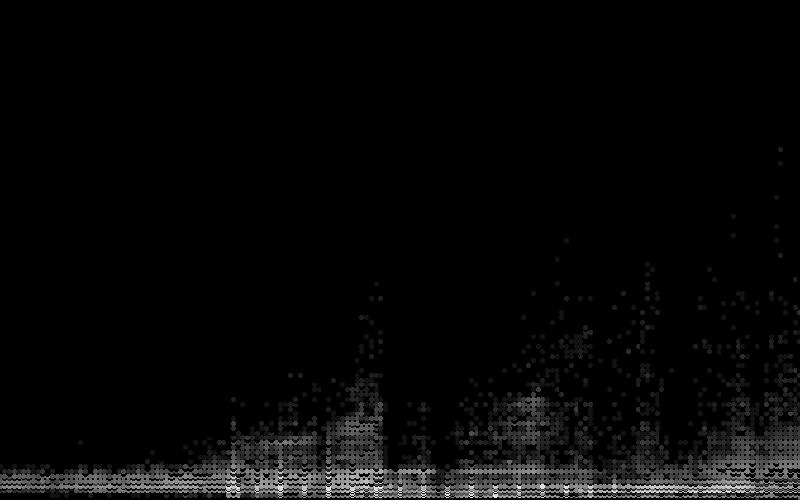

In [21]:
#Defining some helper functions for DataShader
background = 'black'#"#6D6D6D"
export = partial(export_image, background = background, export_path="export")
cm = partial(colormap_select, reverse=(background!="black"))

cvs = ds.Canvas(800, 500, x_range = (ny['yearbuilt'].min(), ny['yearbuilt'].max()), 
                                y_range = (ny['numfloors'].min(), ny['numfloors'].max()))
agg = cvs.points(ny, 'yearbuilt', 'numfloors')
view = tf.shade(agg, cmap = cm(Greys9), how='log')
export(tf.spread(view, px=2), 'yearvsnumfloors')

That's technically just a scatterplot, but the points are smartly placed and colored to mimic what one gets in a heatmap. Based on the pixel size, it will either display individual points, or will color the points of denser regions.

Datashader really shines when looking at geographic information. Here are the latitudes and longitudes of our dataset plotted out, giving us a map of the city colored by density of structures:

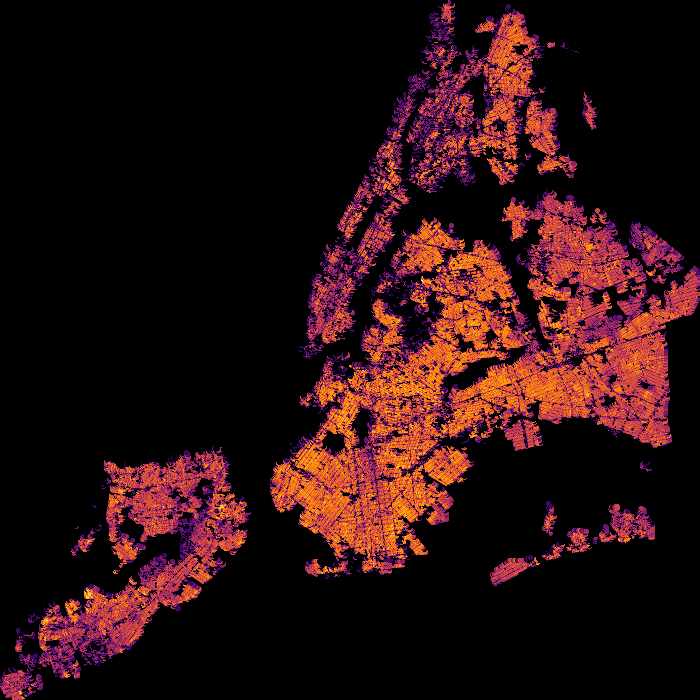

In [22]:
NewYorkCity   = (( 913164.0,  1067279.0), (120966.0, 272275.0))
cvs = ds.Canvas(700, 700, *NewYorkCity)
agg = cvs.points(ny, 'xcoord', 'ycoord')
view = tf.shade(agg, cmap = cm(inferno), how='log')
export(tf.spread(view, px=2), 'firery')

Interestingly, since we're looking at structures, the large buildings of Manhattan show up as less dense on the map. The densest areas measured by number of lots would be single or multi family townhomes.

Unfortunately, Datashader doesn't have the best documentation. Browse through the examples from their [github repo](https://github.com/bokeh/datashader/tree/master/examples). I would focus on the [visualization pipeline](https://anaconda.org/jbednar/pipeline/notebook) and the [US Census](https://anaconda.org/jbednar/census/notebook) Example for the question below. Feel free to use my samples as templates as well when you work on this problem.

### Question

You work for a real estate developer and are researching underbuilt areas of the city. After looking in the [Pluto data dictionary](https://www1.nyc.gov/assets/planning/download/pdf/data-maps/open-data/pluto_datadictionary.pdf?v=17v1_1), you've discovered that all tax assessments consist of two parts: The assessment of the land and assessment of the structure. You reason that there should be a correlation between these two values: more valuable land will have more valuable structures on them (more valuable in this case refers not just to a mansion vs a bungalow, but an apartment tower vs a single family home). Deviations from the norm could represent underbuilt or overbuilt areas of the city. You also recently read a really cool blog post about [bivariate choropleth maps](http://www.joshuastevens.net/cartography/make-a-bivariate-choropleth-map/), and think the technique could be used for this problem.

Datashader is really cool, but it's not that great at labeling your visualization. Don't worry about providing a legend, but provide a quick explanation as to which areas of the city are overbuilt, which areas are underbuilt, and which areas are built in a way that's properly correlated with their land value.

<br>

Pluto gives us two fields, `assessland` and `assesstot`. Therefore, if Pluto tax assessments consist of the assessment of the land and the assessment of the structure, then we can create a feature to represent the value of a structure on a lot by finding:  $\mbox{assesstot}-\mbox{assessland}$  

The following code will select the features needed from `ny` and add a new `assessbuilding` feature:

In [23]:
#select the features needed for the bivariate choropleth map as ny_bvc
ny_bvc = ny[['assesstot','assessland','xcoord','ycoord']].copy()
#add new feature 'assessbuilding'
ny_bvc['assessbuilding'] = ny_bvc['assesstot'].sub(ny_bvc['assessland'], axis=0)

ny_bvc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 810654 entries, 1 to 858187
Data columns (total 5 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   assesstot       810654 non-null  float64
 1   assessland      810654 non-null  float64
 2   xcoord          810580 non-null  float64
 3   ycoord          810580 non-null  float64
 4   assessbuilding  810654 non-null  float64
dtypes: float64(5)
memory usage: 37.1 MB


<br>

The example bivariate choropleth map given in the blog post of Joshua Stevens suggests using a 3 category scheme to recode the data for each variable as low, medium and high. Here, we will use 4 levels to represent the 4 quartiles of the data range:

In [24]:
# use the .describe() method to find quartile values for both distributions
assessland_stats = ny_bvc[['assessland']].describe() 
assessland_cut = [ 0,
                 assessland_stats.loc['25%'][0],
                 assessland_stats.loc['50%'][0],
                 assessland_stats.loc['75%'][0],
                 np.inf ]
assessbuilding_stats = ny_bvc[['assessbuilding']].describe()
assessbuilding_cut = [ 0,
                 assessbuilding_stats.loc['25%'][0],
                 assessbuilding_stats.loc['50%'][0],
                 assessbuilding_stats.loc['75%'][0],
                 np.inf ]
print( assessland_cut)
print( assessbuilding_cut )

[0, 10380.0, 14160.0, 21900.0, inf]
[0, 26640.0, 38880.0, 71160.0, inf]


In [25]:
#Bin and label land and building assessment based on breakpoints, right = False to deal with NaNs
ny_bvc['land'] = pd.cut(ny_bvc['assessland'], 
                         assessland_cut, 
                         right = False, 
                         labels=['land 1st', 'land 2nd', 'land 3rd', 'land 4th'])
ny_bvc['building'] = pd.cut(ny_bvc['assessbuilding'], 
                            assessbuilding_cut, 
                            right = False, 
                            labels=['build 1st', 'build 2nd', 'build 3rd', 'build 4th'])

ny_bvc['bi_class'] = pd.Categorical(ny_bvc['land'].astype(str) + 
                                    ny_bvc['building'].astype(str))

<br>

Now to define a color scheme using an online [Bivariate Choropleth Color Generator](https://observablehq.com/@benjaminadk/bivariate-choropleth-color-generator) with 4 rows. Color poles red and blue were chosen to try to be [colorblind-friendly](https://nowosad.github.io/post/cbc-bp2/)

In [27]:
colors_fig = ["#b9616c", "#914d65", "#6a3a5e", "#432657",
                "#cb9097", "#a0738d", "#755684", "#4a397b",
                "#ddbdc1", "#ad97b5", "#7f71a9", "#504b9d", 
                "#efebeb", "#bcbbdc", "#8a8cce", "#575dbf" ]

x0val = [0, 0.25, 0.5, 0.75, 0, 0.25, 0.50, 0.75, 0, 0.25, 0.5, 0.75, 0, 0.25, 0.5, 0.75]
y0val = [0.75, 0.75, 0.75, 0.75, 0.5, 0.5, 0.5, 0.5, 0.25, 0.25, 0.25, 0.25, 0, 0, 0, 0]
x1val = [0.25, 0.50, 0.75, 1.0, 0.25, 0.50, 0.75, 1.0, 0.25, 0.50, 0.75, 1.0, 0.25, 0.50, 0.75, 1.0]
y1val = [1.0, 1.0, 1.0, 1.0, 0.75, 0.75, 0.75, 0.75, 0.5, 0.5, 0.5, 0.5, 0.25, 0.25, 0.25, 0.25]

#visualize the color scheme with labels
fig = go.Figure()

# Set axes properties
fig.update_xaxes(range=[0, 4])
fig.update_yaxes(range=[0, 4])

for idx, colorval in enumerate( colors ):
    # Add shapes
    fig.add_shape(type="rect",
        xref="paper", yref="paper",
        x0=x0val[idx], y0=y0val[idx],
        x1=x1val[idx], y1=y1val[idx],
        line=dict(
            color=colorval,
            width=3,
        ),
        fillcolor=colorval,
    )

fig.update_layout(height=800, width=800, template = "plotly_white", 
                  title_text="Bivariate Color Scheme Map",
                  xaxis_title="Assessment of the Land",
                  yaxis_title="Assessment of the Building",)
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.show()

And now to plug our values and color scheme into the example template given above:

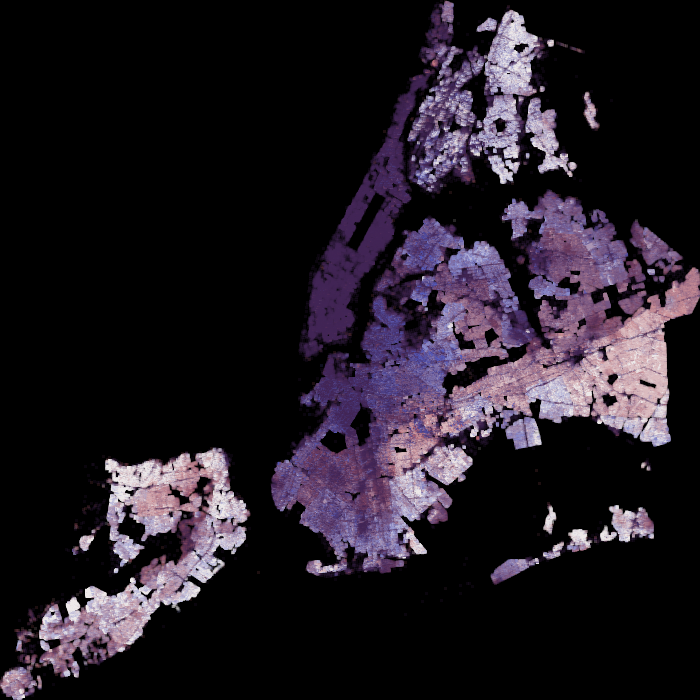

In [29]:
colors = ["#efebeb", "#bcbbdc", "#8a8cce", "#575dbf", 
              "#ddbdc1", "#ad97b5", "#7f71a9", "#504b9d", 
              "#cb9097", "#a0738d", "#755684", "#4a397b", 
              "#b9616c", "#914d65", "#6a3a5e", "#432657"]
#Setup canvas
NewYorkCity   = ((913164.0,  1067279.0), (120966.0, 272275.0))
cvs = ds.Canvas(700, 700, *NewYorkCity)

#Populate canvas
agg = cvs.points(ny_bvc, 'xcoord', 'ycoord', ds.count_cat('bi_class'))
view = tf.shade(agg, color_key=colors)
export(tf.spread(view, px=1), 'choropleth')

**Interpretting the Bivariate Choropleth**  

Our hypothesis: `assessland` and `assesbuilding` are correlated. Therefore more valuable land will have more valuable structures on them. Deviations from the norm could represent underbuilt or overbuilt areas of the city.  

Assuming our hypothesis is true, areas of high correlation between the assessment of land and the structures on them will render in our bivariate choropleth plot as a deep purple. The entire borough of Manhattan, much of Downtown Brooklyn and some regions of Queens that are close to Manhattan are shaded a deep purple indicating that these properties have a correlated high land and high building value assessments. There are several patches of NYC that appear as a light grayish white: areas in the Bronx, parts of Staten Island, East New York (Brooklyn) and areas of Queens near JFK; this suggests a correlated low land and low building value assessment.  

Our goal is to identify underbuilt regions in NYC for our real estate developer client. We are not interested in areas of high correlation, rather, we are interested in areas that deviate. Regions shaded red indicate a relatively low land value compared to the value of the buildings; this would suggest the area is overbuilt. We are interested in underbuilt areas where the value of the buildings is relatively low compared to the value of the land. Such an area would render blue in our bivariate choropleth map. We see that regions near the Brooklyn/Queens border (Bushwick/Ridgewood/Maspeth) and areas of South Brooklyn (Sheepshead Bay & Bensonhurst?) have a solid blue coloration indicating that the land value is much higher compared to the assessment of the current structures making the neighborhood a good investment for further development.  

<br>

### References

1. He, Sijia, et al. "Three-dimensional urban expansion analysis of valley-type cities: A case study of chengguan district, lanzhou, china." Sustainability 11.20 (2019): 5663.
2. [A brief history of New York City's real estate market](https://medium.com/@teamnycrec/a-brief-history-of-new-york-citys-real-estate-market-841a724439ca)
3. [Make a Bivariate Choropleth Map](https://www.joshuastevens.net/cartography/make-a-bivariate-choropleth-map/)
4. [Bivariate Choropleth Color Generator](https://observablehq.com/@benjaminadk/bivariate-choropleth-color-generator)
5. [colorblind-friendly](https://nowosad.github.io/post/cbc-bp2/)

<br><br>